In [2]:
#Import all relevant libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import zscore
from ydata_profiling import ProfileReport
import sweetviz as sv
import plotly.express as px


from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn import metrics
 
## This statement allows the visuals to render within your Jupyter Notebook.
%matplotlib inline

## Loading the data
We can now load the dataset into pandas using the read_csv() function. This converts the CSV file into a Pandas dataframe.

In [3]:
#Read in the csv file and convert to a Pandas dataframe
df_goalkeeper = pd.read_csv('goalkeeper.csv')
df_goalkeeper.head()


,Unnamed: 0,team,name,position,height,age,appearance,goals,assists,yellow cards,...,red cards,goals conceded,clean sheets,minutes played,days_injured,games_injured,award,current_value,highest_value,winger
0,0,Manchester United,David de Gea,Goalkeeper,189.0,32.0,104,0.0,0.0,0.009585,...,0.0,1.217252,0.335463,9390,42,5,13,15000000,70000000,0
1,1,Manchester United,Jack Butland,Goalkeeper,196.0,30.0,15,0.0,0.0,0.069018,...,0.0,1.242331,0.207055,1304,510,58,1,1500000,22000000,0
2,2,Manchester United,Tom Heaton,Goalkeeper,188.0,37.0,4,0.0,0.0,0.000000,...,0.0,0.616438,0.924658,292,697,84,4,600000,6000000,0
3,32,West Ham United,Alphonse Areola,Goalkeeper,195.0,30.0,41,0.0,0.0,0.000000,...,0.0,0.898502,0.449251,3606,34,4,16,8000000,17500000,0
4,33,West Ham United,Lukasz Fabianski,Goalkeeper,190.0,38.0,75,0.0,0.0,0.040767,...,0.0,1.331723,0.271780,6623,554,99,4,1000000,9000000,0


## 1. Data Profiling:
Data profiling is a comprehensive process of examining the data available in an existing dataset and collecting statistics and information about that data. 

In [5]:
profile = ProfileReport(df, title="Pandas Profiling Report")
profile.to_notebook_iframe()


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Data Quality Checks and Data Cleaning:

In [ ]:
#I skipped what I did in the first notebook.

#### 4. Relevance: 



In [4]:
#drop irrelevant columns
df_goalkeeper.drop(columns='goals', inplace = True)
df_goalkeeper.drop(columns='assists', inplace = True)
df_goalkeeper.drop(columns='position', inplace = True)
df_goalkeeper.drop(columns='winger', inplace = True)
df_goalkeeper.drop(columns='Unnamed: 0', inplace = True)

In [8]:
df_goalkeeper.head()

,team,name,height,age,appearance,yellow cards,second yellow cards,red cards,goals conceded,clean sheets,minutes played,days_injured,games_injured,award,current_value,highest_value
0,Manchester United,David de Gea,189.0,32.0,104,0.009585,0.0,0.0,1.217252,0.335463,9390,42,5,13,15000000,70000000
1,Manchester United,Jack Butland,196.0,30.0,15,0.069018,0.0,0.0,1.242331,0.207055,1304,510,58,1,1500000,22000000
2,Manchester United,Tom Heaton,188.0,37.0,4,0.000000,0.0,0.0,0.616438,0.924658,292,697,84,4,600000,6000000
3,West Ham United,Alphonse Areola,195.0,30.0,41,0.000000,0.0,0.0,0.898502,0.449251,3606,34,4,16,8000000,17500000
4,West Ham United,Lukasz Fabianski,190.0,38.0,75,0.040767,0.0,0.0,1.331723,0.271780,6623,554,99,4,1000000,9000000


In [9]:
multiply = ['yellow cards', 'second yellow cards', 'red cards','goals conceded', 'clean sheets']
#Convert the column to its previous number before scaling and save it in a new column.
for column in multiply:
    name = column + '_total'
    df_goalkeeper[name] = df_goalkeeper[column] * df_goalkeeper['appearance']

In [9]:
df_goalkeeper.shape

(1229, 21)

In [10]:
df_goalkeeper.columns

Index(['team', 'name', 'height', 'age', 'appearance', 'yellow cards',
       'second yellow cards', 'red cards', 'goals conceded', 'clean sheets',
       'minutes played', 'days_injured', 'games_injured', 'award',
       'current_value', 'highest_value', 'yellow cards_total',
       'second yellow cards_total', 'red cards_total', 'goals conceded_total',
       'clean sheets_total'],
      dtype='object')

In [7]:
profile3 = ProfileReport(df_goalkeeper, title="Pandas Profiling Report")
profile3.to_notebook_iframe()


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Check and handle outliers

In [ ]:
#I already checked the outliers. I will show you what I changed

**Award**

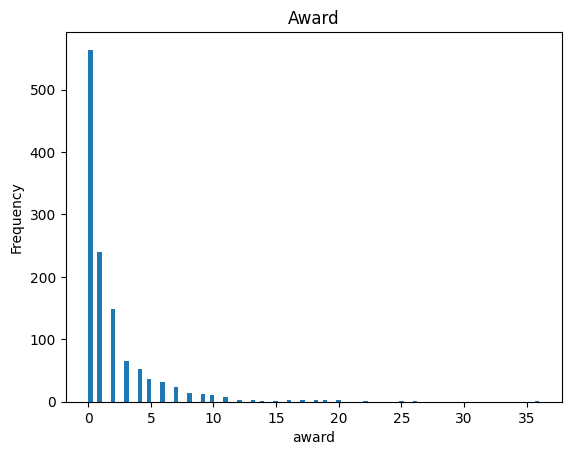

In [15]:
plt.hist(df_goalkeeper['award'], bins = 100)
plt.title('Award')
plt.xlabel('award')
plt.ylabel('Frequency')
plt.show()


In [18]:
df_goalkeeper = df_goalkeeper[df_goalkeeper["award"] <= 20]

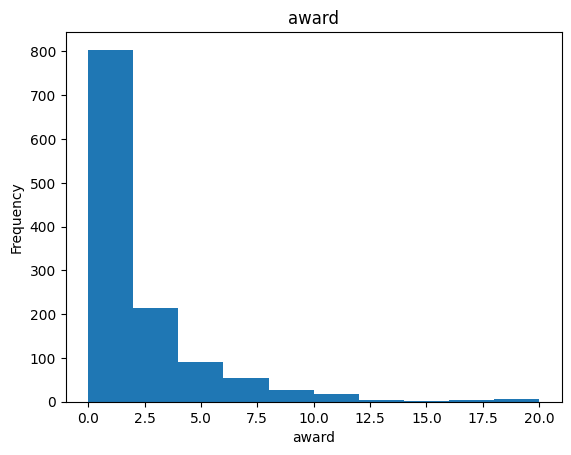

In [19]:
plt.hist(df_goalkeeper['award'])
plt.title('award')
plt.xlabel('award')
plt.ylabel('Frequency')
plt.show()


**Clean sheets total**

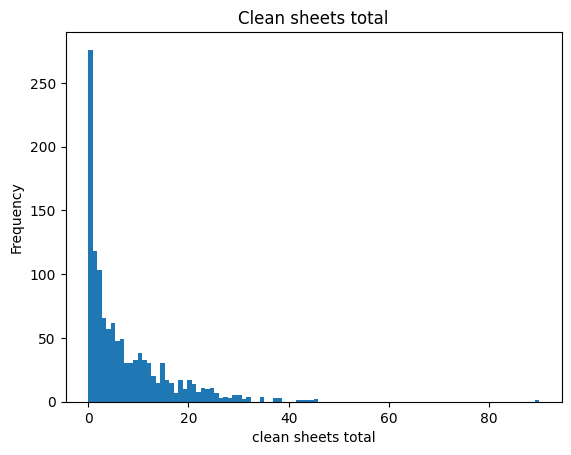

In [24]:
plt.hist(df_goalkeeper['clean sheets_total'], bins = 100)
plt.title('Clean sheets total')
plt.xlabel('clean sheets total')
plt.ylabel('Frequency')
plt.show()


In [26]:
df_goalkeeper = df_goalkeeper[df_goalkeeper["clean sheets_total"] <40]

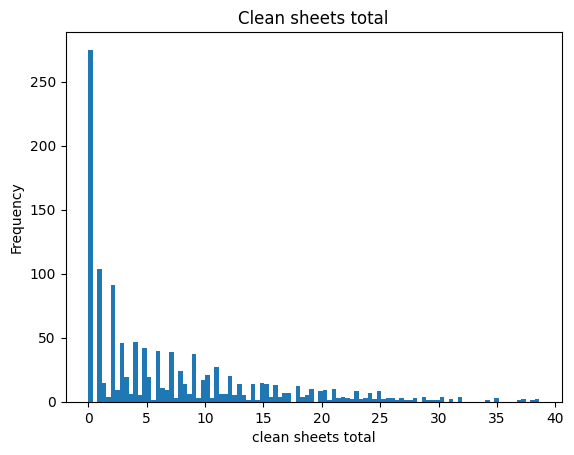

In [27]:
plt.hist(df_goalkeeper['clean sheets_total'], bins = 100)
plt.title('Clean sheets total')
plt.xlabel('clean sheets total')
plt.ylabel('Frequency')
plt.show()


**Days injured**

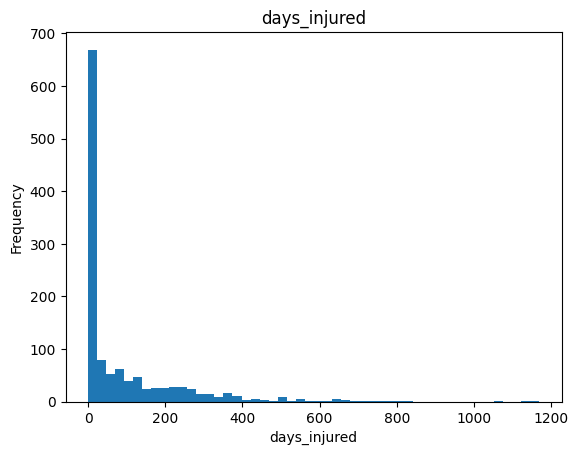

In [40]:
plt.hist(df_goalkeeper['days_injured'], bins = 50)
plt.title('days_injured')
plt.xlabel('days_injured')
plt.ylabel('Frequency')
plt.show()

In [43]:
df_goalkeeper = df_goalkeeper[df_goalkeeper["days_injured"] <= 800]


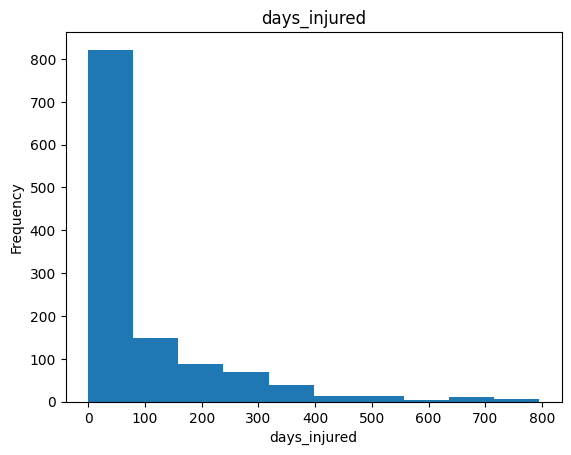

In [44]:
plt.hist(df_goalkeeper['days_injured'])
plt.title('days_injured')
plt.xlabel('days_injured')
plt.ylabel('Frequency')
plt.show()

**Games injured**

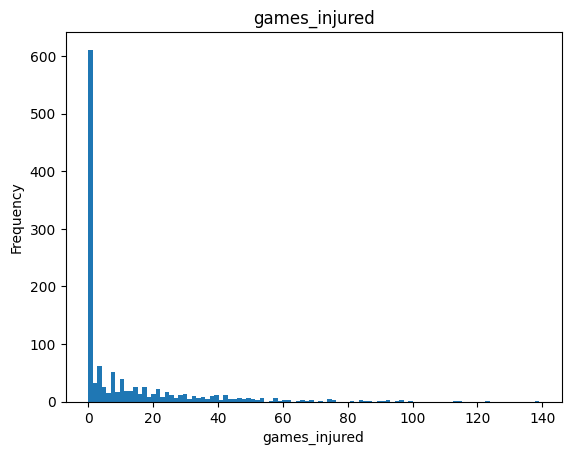

In [41]:
plt.hist(df_goalkeeper['games_injured'], bins = 100)
plt.title('games_injured')
plt.xlabel('games_injured')
plt.ylabel('Frequency')
plt.show()

In [45]:
df_goalkeeper = df_goalkeeper[df_goalkeeper["games_injured"] <= 100]

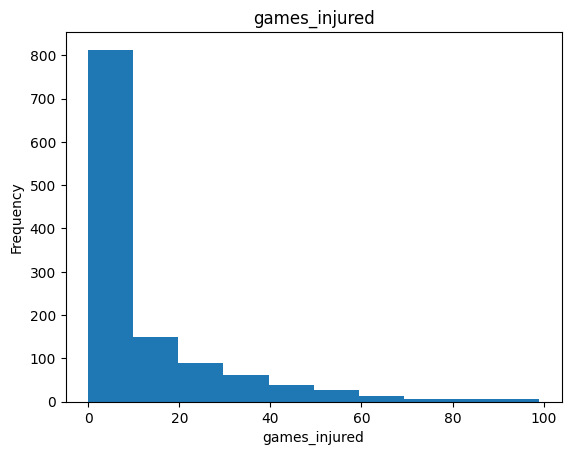

In [47]:
plt.hist(df_goalkeeper['games_injured'])
plt.title('games_injured')
plt.xlabel('games_injured')
plt.ylabel('Frequency')
plt.show()

**Goals conceded**

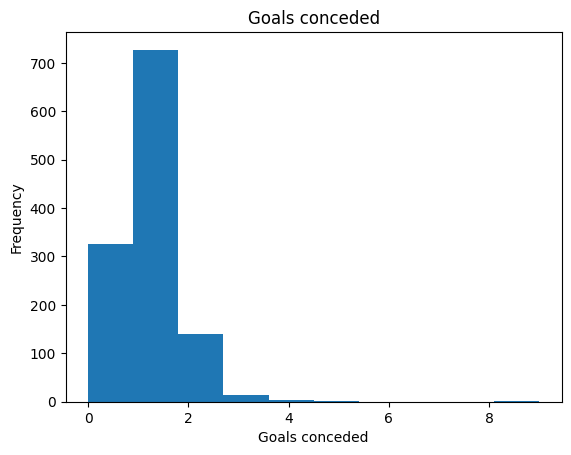

In [48]:
plt.hist(df_goalkeeper['goals conceded'])
plt.title('Goals conceded')
plt.xlabel('Goals conceded')
plt.ylabel('Frequency')
plt.show()

In [55]:
df_goalkeeper = df_goalkeeper[df_goalkeeper["goals conceded"] <= 5]

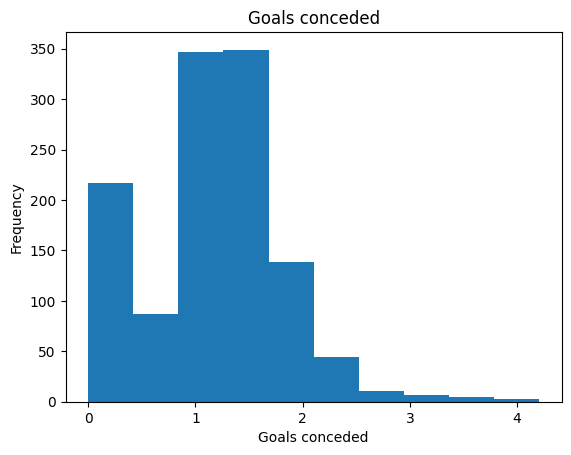

In [56]:
plt.hist(df_goalkeeper['goals conceded'])
plt.title('Goals conceded')
plt.xlabel('Goals conceded')
plt.ylabel('Frequency')
plt.show()